In [1]:
import requests
import pandas as pd
import re
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.cm
from mpl_toolkits.basemap import Basemap
from matplotlib.patches import Polygon
from matplotlib.collections import PatchCollection
from matplotlib.colors import Normalize
from itertools import chain
import pydeck as pdk

import warnings
warnings.filterwarnings(action='ignore')

In [2]:
### SQRQL WIKI query

url = 'https://query.wikidata.org/sparql'

query = '''
 #defaultView:Map
SELECT ?person ?personLabel ?article ?birthplaceLabel ?birthdate ?coord WHERE {
  # Person is a Polish national
  ?person wdt:P27 wd:Q212.
  
  # Person has a Polish Wikipedia article
  ?article schema:about ?person;
           schema:isPartOf <https://uk.wikipedia.org/>.

  # Person has a birthplace with coordinates
  ?person wdt:P19 ?birthplace.
  ?birthplace wdt:P625 ?coord.

  # Optional: Limit to people born after 1900 (change if needed)
  ?person wdt:P569 ?birthdate.
  #FILTER(YEAR(?birthdate) >= 1800 && (YEAR(?birthdate) < 1950))
  FILTER(YEAR(?birthdate) >= 1700)
  
  
  SERVICE wikibase:label { bd:serviceParam wikibase:language "uk". }
}
LIMIT 30000
'''

In [3]:
### Retrieve data baesd on query
r = requests.get(url, params = {'format': 'json', 'query': query})
data = r.json()

In [4]:
### Extact coordinates
cord = []
for x in range(0, len(data['results']['bindings'])):
    temp = data['results']['bindings'][x]
    temp_coord = temp['coord']['value']
    temp_person = temp['personLabel']['value']
    temp_birthplace = temp['birthplaceLabel']['value']
    lat = re.findall(r"Point\((-?\d+.\d+)", temp_coord)
    long = re.findall(r"Point\(-?\d+.\d+\s+(-?\d+.\d+)", temp_coord)
    article = temp['article']['value']
    birthday = str(pd.Timestamp(temp['birthdate']['value']).date())
    cord.append([float(lat[0]), float(long[0]), temp_person, temp_birthplace, birthday, article])

cord_df = pd.DataFrame(cord, columns=['Long', 'Lat', 'PersonName', 'BirthPlace', 'Birthday', 'Article'])

#cord_df.to_csv("ukrainians.csv", index=False, sep=',')

In [5]:
print(cord_df.shape)
cord_df.head()

(28302, 6)


,Long,Lat,PersonName,BirthPlace,Birthday,Article
0,24.925556,50.745833,Павлюк Ігор Зиновійович,Малий Окорськ,1967-01-01,https://uk.wikipedia.org/wiki/%D0%9F%D0%B0%D0%...
1,16.365000,48.207500,Софрон (Дмитерко),Австро-Угорщина,1917-06-01,https://uk.wikipedia.org/wiki/%D0%A1%D0%BE%D1%...
2,22.295000,48.623889,Балла Карой Ласлович,Ужгород,1957-01-17,https://uk.wikipedia.org/wiki/%D0%91%D0%B0%D0%...
3,28.250000,47.716667,Тігіпко Сергій Леонідович,Дрегенешти,1960-02-13,https://uk.wikipedia.org/wiki/%D0%A2%D1%96%D0%...
4,34.100039,44.948376,Щедов Віталій Володимирович,Сімферополь,1987-07-31,https://uk.wikipedia.org/wiki/%D0%A9%D0%B5%D0%...


In [6]:
### Process SPARQL response and add small noise for observations with same coordinates
mu, sigma = 0, 0.02

cord_df['Temp'] = cord_df.BirthPlace+cord_df.Long.astype(str)+cord_df.Lat.astype(str)
cord_noise_df = pd.DataFrame()
for place in cord_df.Temp.unique():
    temp = cord_df[cord_df.Temp==place].drop('Temp', axis=1)
    sigma = np.log(len(temp))/150
    temp['Long2'] =  [x+np.random.normal(mu, sigma) for x in temp.Long]
    temp['Lat2'] =  [x+np.random.normal(mu, sigma) for x in temp.Lat]
    cord_noise_df = cord_noise_df._append(temp)

In [7]:
#cord_noise_df.to_excel("cord_noise_df.xlsx", index=False)  
#cord_noise_df = pd.read_excel("cord_noise_df.xlsx")

### Visualization with Basemap

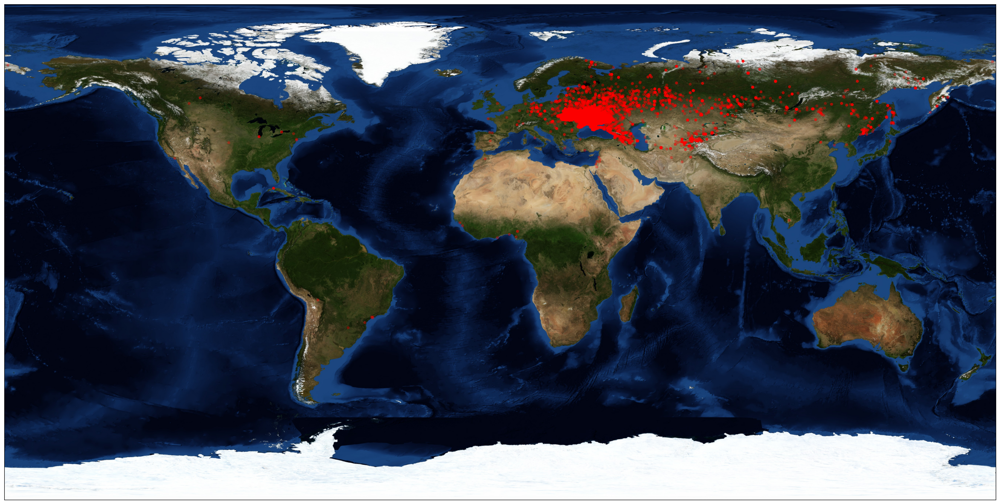

In [8]:
def draw_map(m, scale=0.2):
    # draw a shaded-relief image
    m.shadedrelief(scale=scale)
    
    # lats and longs are returned as a dictionary
    lats = m.drawparallels(np.linspace(-90, 90, 13))
    lons = m.drawmeridians(np.linspace(-180, 180, 13))

    # keys contain the plt.Line2D instances
    lat_lines = chain(*(tup[1][0] for tup in lats.items()))
    lon_lines = chain(*(tup[1][0] for tup in lons.items()))
    all_lines = chain(lat_lines, lon_lines)
    
    # cycle through these lines and set the desired style
    for line in all_lines:
        line.set(linestyle='-', alpha=0.3, color='w')

fig = plt.figure(figsize=(30, 20), edgecolor='w')
m = Basemap(projection='cyl', resolution=None,
            llcrnrlat=-90, urcrnrlat=90,
            llcrnrlon=-180, urcrnrlon=180)
m.bluemarble()
plt.scatter(cord_noise_df.Long2.values, cord_noise_df.Lat2.values, s=15, alpha=0.3, c='r')

plt.show()

### Interactive Visualisation with Pydeck

In [9]:
### Create syntetic variable coordinates
cord_df2 = cord_noise_df[['Long2','Lat2','PersonName','BirthPlace','Birthday', 'Article']]
cord_df2['coordinates'] = [[x,y] for x,y in zip(cord_df2.Long2, cord_df2.Lat2)]
cord_df2 = cord_df2.rename(columns={'Lat2':'Latitude', 'Long2':'Longitude'})


layer = pdk.Layer(
    "ScatterplotLayer",
    cord_df2,
    pickable=True,
    opacity=0.5,
    stroked=True,
    filled=True,
    extruded=True,
    wireframe=True,
    auto_highlight=True,
    radius_scale=15,
    radius_min_pixels=2.5,
    radius_max_pixels=10,
    line_width_min_pixels=1,
    get_position="coordinates",
    #get_radius="exits_radius",
    get_fill_color=[255, 140, 0],
    get_line_color=[0, 0, 0],
    #on_click=on_click()
)

# Set the viewport location
view_state = pdk.ViewState(
    longitude=70,
    latitude=52,
    zoom=2,
    min_zoom=0,
    max_zoom=20,
#    pitch=40.5,
#    bearing=-27.36,
)
tooltip = {"html": """<b>Ім'я:</b>{PersonName}<br /><b>Місце народження:</b>{BirthPlace}<br /><b>Дата народження:</b>{Birthday}<br /><b>
                        Довгота:</b>{Longitude}<br /><b>Широта:</b> {Latitude}
                        """
          }

r = pdk.Deck(layers=[layer], initial_view_state=view_state, tooltip=tooltip)

### Save to html
r.to_html("index.html")